# GAN (Generative Adversarial Network)

In [1]:
import torch
import torch.nn as nn
import torch.nn.parallel
import torch.optim as optim
import torch.utils.data
import torchvision.datasets as dset
import torchvision.transforms.v2 as transforms
import torchvision.utils as vutils
import numpy as np
import matplotlib.pyplot as plt
import matplotlib

In [2]:
DATA_DIR = "./data"
DATALOAD_THREADS = 2
BATCH_SIZE = 128
# Also size of feature maps for generator and discriminator
IMG_SIZE = 128
# Size of z latent vector / generator input
Z_SIZE = 100

EPOCHS = 15
LR = 0.0002

# hyperparameter for Adam optimizers
BETA1 = 0.5
NGPU = 1

/home/vinay/Code/ML/implems/.conda/lib/python3.12/site-packages/torchvision/transforms/v2/_deprecated.py:41: UserWarning: The transform `ToTensor()` is deprecated and will be removed in a future release. Instead, please use `v2.Compose([v2.ToImage(), v2.ToDtype(torch.float32, scale=True)])`.
  warnings.warn(


cuda:0


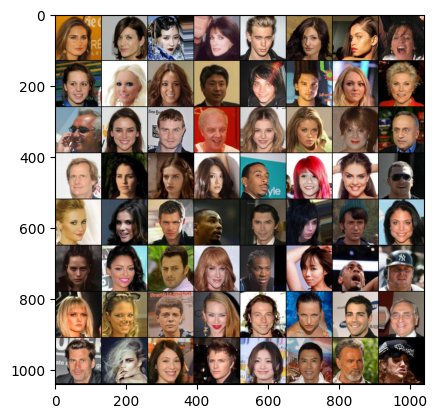

In [3]:
dataset = dset.ImageFolder(root=DATA_DIR,
                            transform=transforms.Compose([
                                    transforms.Resize(IMG_SIZE),
                                    transforms.CenterCrop(IMG_SIZE),
                                    # transforms.RandomResizedCrop(size=(224, 224), antialias=True),
                                    # transforms.RandomHorizontalFlip(p=0.5),
                                    # transforms.RandomRotation(15),
                                    # transforms.RandomAutocontrast(p=0.5),
                                    # transforms.ColorJitter(),
                                    transforms.ToTensor(),
                                    transforms.Normalize((0.5, 0.5, 0.5), (0.5, 0.5, 0.5)),
                            ]))
dataloader = torch.utils.data.DataLoader(dataset, batch_size=BATCH_SIZE,
                                         shuffle=True, num_workers=DATALOAD_THREADS)

device = torch.device("cuda:0" if (torch.cuda.is_available()) and NGPU>0 else "cpu")
print(device)

plt.imshow(np.transpose(vutils.make_grid(next(iter(dataloader))[0].to(device)[:64], padding=2, normalize=True).cpu(),(1,2,0)))

In [12]:
# Consult gan/explanation.md for more information on how this model works.

def weights_init(m):
    '''
    Method to initialize weights for Generator and Discriminator networks
    '''
    classname = m.__class__.__name__
    if classname.find('Conv') != -1:
        nn.init.normal_(m.weight.data, 0.0, 0.02)
    elif classname.find('BatchNorm') != -1:
        nn.init.normal_(m.weight.data, 1.0, 0.02)
        nn.init.constant_(m.bias.data, 0)

class Generator(nn.Module):
    def __init__(self, NGPU, IMG_SIZE, IMG_CHANNELS, Z_SIZE):
        '''
        Initializes the Generator transposed convolutional neural network. 
        IMG_SIZE is the feature map size and Z_SIZE is the size of the latent vector input.
        '''
        super(Generator, self).__init__()
        self.ngpu = NGPU
        self.main = nn.Sequential(
            # input is Z, going into a convolution
            nn.ConvTranspose2d(Z_SIZE, IMG_SIZE * 8, 4, 1, 0, bias=False),
            nn.BatchNorm2d(IMG_SIZE * 8),
            nn.ReLU(True),
            # state size. ``(IMG_SIZE*8) x 4 x 4``
            nn.ConvTranspose2d(IMG_SIZE * 8, IMG_SIZE * 4, 4, 2, 1, bias=False),
            nn.BatchNorm2d(IMG_SIZE * 4),
            nn.ReLU(True),
            # state size. ``(IMG_SIZE*4) x 8 x 8``
            nn.ConvTranspose2d(IMG_SIZE * 4, IMG_SIZE * 2, 4, 2, 1, bias=False),
            nn.BatchNorm2d(IMG_SIZE * 2),
            nn.ReLU(True),
            # state size. ``(IMG_SIZE*2) x 16 x 16``
            nn.ConvTranspose2d(IMG_SIZE * 2, IMG_SIZE, 4, 2, 1, bias=False),
            nn.BatchNorm2d(IMG_SIZE),
            nn.ReLU(True),
            # state size. ``(IMG_SIZE) x 32 x 32``
            nn.ConvTranspose2d(IMG_SIZE, IMG_CHANNELS, 4, 2, 1, bias=False),
            nn.Tanh()
            # state size. ``(3) x 64 x 64``
        )
        self.apply(weights_init)

    def forward(self, input):
        return self.main(input)
    
class Discriminator(nn.Module):
    def __init__(self, NGPU, IMG_SIZE, IMG_CHANNELS):
        '''
        Initializes the Discriminator convolutional neural network. 
        IMG_SIZE is the feature map size.
        '''
        super(Discriminator, self).__init__()
        self.ngpu = NGPU
        self.main = nn.Sequential(
            # input is ``(3) x 64 x 64``
            nn.Conv2d(IMG_CHANNELS, IMG_SIZE, 4, 2, 1, bias=False),
            nn.LeakyReLU(0.2, inplace=True),
            # state size. ``(IMG_SIZE) x 32 x 32``
            nn.Conv2d(IMG_SIZE, IMG_SIZE * 2, 4, 2, 1, bias=False),
            nn.BatchNorm2d(IMG_SIZE * 2),
            nn.LeakyReLU(0.2, inplace=True),
            # state size. ``(IMG_SIZE*2) x 16 x 16``
            nn.Conv2d(IMG_SIZE * 2, IMG_SIZE * 4, 4, 2, 1, bias=False),
            nn.BatchNorm2d(IMG_SIZE * 4),
            nn.LeakyReLU(0.2, inplace=True),
            # state size. ``(IMG_SIZE*4) x 8 x 8``
            nn.Conv2d(IMG_SIZE * 4, IMG_SIZE * 8, 4, 2, 1, bias=False),
            nn.BatchNorm2d(IMG_SIZE * 8),
            nn.LeakyReLU(0.2, inplace=True),
            # state size. ``(IMG_SIZE*8) x 4 x 4``
            nn.Conv2d(IMG_SIZE * 8, 1, 4, 1, 0, bias=False),
            nn.Sigmoid()
        )
        self.apply(weights_init)

    def forward(self, input):
        return self.main(input)

In [13]:
netG = Generator(NGPU, IMG_SIZE, 3, Z_SIZE).to(device)
netD = Discriminator(NGPU, IMG_SIZE, 3).to(device)

if (device.type == 'cuda') and (NGPU > 1):
    netG = nn.DataParallel(netG, list(range(NGPU)))
    netD = nn.DataParallel(netD, list(range(NGPU)))

from torchsummary import summary
summary(netD, (3, IMG_SIZE, IMG_SIZE))
summary(netG, (100))

----------------------------------------------------------------
        Layer (type)               Output Shape         Param #
            Conv2d-1          [-1, 128, 64, 64]           6,144
         LeakyReLU-2          [-1, 128, 64, 64]               0
            Conv2d-3          [-1, 256, 32, 32]         524,288
       BatchNorm2d-4          [-1, 256, 32, 32]             512
         LeakyReLU-5          [-1, 256, 32, 32]               0
            Conv2d-6          [-1, 512, 16, 16]       2,097,152
       BatchNorm2d-7          [-1, 512, 16, 16]           1,024
         LeakyReLU-8          [-1, 512, 16, 16]               0
            Conv2d-9           [-1, 1024, 8, 8]       8,388,608
      BatchNorm2d-10           [-1, 1024, 8, 8]           2,048
        LeakyReLU-11           [-1, 1024, 8, 8]               0
           Conv2d-12              [-1, 1, 5, 5]          16,384
          Sigmoid-13              [-1, 1, 5, 5]               0
Total params: 11,036,160
Trainable para

TypeError: 'int' object is not iterable

In [ ]:
criterion = nn.BCELoss()

fixed_noise = torch.randn(64, Z_SIZE, 1, 1, device=device)

REAL = 1.
FAKE = 0.

optimizerD = optim.SGD(netD.parameters(), lr=LR)
optimizerG = optim.Adam(netG.parameters(), lr=LR, betas=(BETA1, 0.999))

In [ ]:
img_list = []
G_losses = []
D_losses = []
iters = 0

print("Starting Training Loop...")

for epoch in range(EPOCHS):
    # batches dataloader
    for batch_index, batch in enumerate(dataloader):

        # Discriminator training: maximizes log(D(x)) + log(1 - D(G(z)))
        def discriminatorLoss(realPreds, fakePreds):
            return -torch.mean(torch.log(realPreds) + torch.log(1 - fakePreds))
        
        # train with real batch from training data
        netD.zero_grad()
        real_cpu = batch[0].to(device) 
        b_size = real_cpu.size(0)
        realPreds = netD(real_cpu).view(-1)
        D_x = realPreds.mean().item()

        # train with generated batch from G
        z = torch.randn(b_size, Z_SIZE, 1, 1, device=device)
        fake = netG(z)
        fakePreds = netD(fake.detach()).view(-1)
        D_G_z1 = fakePreds.mean().item()

        # updates D
        lossD = discriminatorLoss(realPreds, fakePreds)
        lossD.backward()
        optimizerD.step()

        # Generator training: maximize log(D(G(z)))
        # Instead of minimizing log(1 - D(G(z))) we maximize log(D(G(z))) for better gradient descent.
        def generatorLoss(fakePreds):
            return -torch.mean(torch.log(fakePreds))
        
        netG.zero_grad()

        fakePreds = netD(fake).view(-1)
        D_G_z2 = fakePreds.mean().item()

        # updates G
        lossG = generatorLoss(fakePreds)
        lossG.backward()
        optimizerG.step()

        if batch_index % 50 == 0:
            print('[%d/%d][%d/%d]\tLoss_D: %.4f\tLoss_G: %.4f\tD(x): %.4f\tD(G(z)): %.4f / %.4f'
                  % (epoch+1, EPOCHS, batch_index, len(dataloader),
                     lossD.item(), lossG.item(), D_x, D_G_z1, D_G_z2))

        G_losses.append(lossG.item())
        D_losses.append(lossD.item())

        # Check generator's progress accuracy fixed noise
        if (batch_index % 500 == 0) or ((epoch == EPOCHS-1) and (batch_index == len(dataloader)-1)):
            with torch.no_grad():
                fake = netG(fixed_noise).detach().cpu()
            img_list.append(vutils.make_grid(fake, padding=2, normalize=True))
            

Starting Training Loop...


RuntimeError: Calculated padded input size per channel: (2 x 2). Kernel size: (4 x 4). Kernel size can't be greater than actual input size

Model is prone to overfitting / getting stuck
> `[13/15][150/1583]	Loss_D: 0.0014	Loss_G: 6.9735	D(x): 0.9996	D(G(z)): 0.0009 / 0.0009`

With 5-10 epochs somewhat favorable results are produced

Animation size has reached 25875539 bytes, exceeding the limit of 25165824.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.


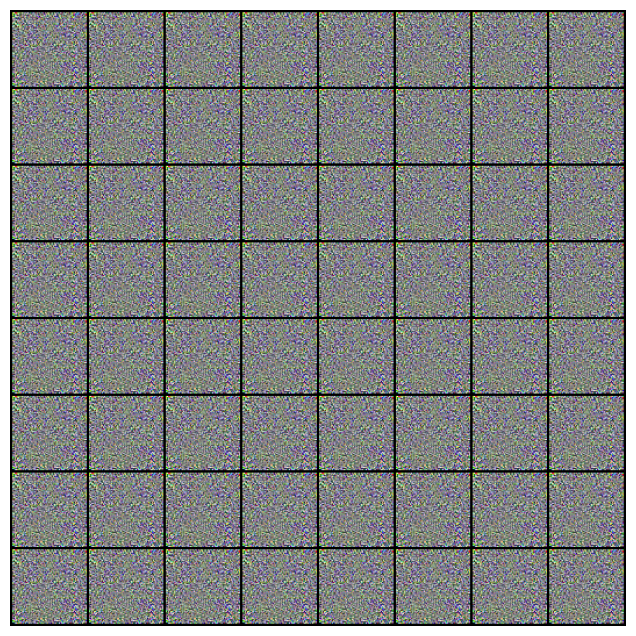

In [ ]:
from IPython.display import HTML
import matplotlib.animation as animation
fig = plt.figure(figsize=(8,8))
plt.axis("off")
ims = [[plt.imshow(np.transpose(i,(1,2,0)), animated=True)] for i in img_list]
ani = animation.ArtistAnimation(fig, ims, interval=1000, repeat_delay=1000, blit=True)
matplotlib.rcParams['animation.embed_limit'] = 24

HTML(ani.to_jshtml())